In [70]:
import rasterio
from rasterio.windows import Window

with rasterio.open('../S2A_MSIL2A_20200530T105031_N0214_R051_T31UET_20200530T134211.SAFE/GRANULE/L2A_T31UET_A025788_20200530T105134/IMG_DATA/R10m/T31UET_20200530T105031_B02_10m.jp2') as src:
    row, col = src.index(601200, 5773695)
    b2 = src.read(1, window=Window(row_off = row, col_off=col,height=500, width=700))

with rasterio.open('../S2A_MSIL2A_20200530T105031_N0214_R051_T31UET_20200530T134211.SAFE/GRANULE/L2A_T31UET_A025788_20200530T105134/IMG_DATA/R10m/T31UET_20200530T105031_B03_10m.jp2') as src:
    row, col = src.index(601200, 5773695)
    b3 = src.read(1, window=Window(row_off = row, col_off=col,height=500, width=700))

with rasterio.open('../S2A_MSIL2A_20200530T105031_N0214_R051_T31UET_20200530T134211.SAFE/GRANULE/L2A_T31UET_A025788_20200530T105134/IMG_DATA/R10m/T31UET_20200530T105031_B04_10m.jp2') as src:
    row, col = src.index(601200, 5773695)
    b4 = src.read(1, window=Window(row_off = row, col_off=col,height=500, width=700))

with rasterio.open('../S2A_MSIL2A_20200530T105031_N0214_R051_T31UET_20200530T134211.SAFE/GRANULE/L2A_T31UET_A025788_20200530T105134/IMG_DATA/R10m/T31UET_20200530T105031_B08_10m.jp2') as src:
    row, col = src.index(601200, 5773695)
    b8 = src.read(1, window=Window(row_off = row, col_off=col,height=500, width=700))
    


b8.shape

(500, 700)

In [48]:
b8list = []
for listt in b8:
    for item in listt:
        b8list.append(item)

b4list = []
for listt in b4:
    for item in listt:
        b4list.append(item)

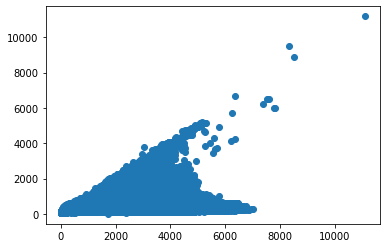

In [73]:
import matplotlib.pyplot as plt
%matplotlib inline

# plt.imshow(b2)
# plt.show()

fig = plt.figure()
ax1 = fig.add_subplot(111)
ax1.scatter(b8, b4)
plt.show()

In [84]:
from sklearn.cluster import KMeans
import matplotlib.pyplot as plt
%matplotlib inline

cl = KMeans(n_clusters=4) # create an object of the classifier
param = cl.fit(b4) # train it
img_cl = cl.labels_ # get the labels of the classes
img_cl = img_cl.reshape(b8[:,0].shape) # reshape labels to a 3d array (one band only)

# Create a custom color map to represent our different 4 classes
# cmap = mc.LinearSegmentedColormap.from_list("", ["black","red","green","yellow"])
# Show the resulting array and save it as jpg image
# plt.figure(figsize=[20,20])
# plt.imshow(img_cl)
# plt.axis('off')
# # plt.savefig("elhas_clustered.jpg", bbox_inches='tight')
# plt.show()

fig = plt.figure()
ax1 = fig.add_subplot(111)
ax1.scatter(img_cl, b4)
plt.show()

ValueError: x and y must be the same size

In [ ]:
from sklearn.cluster import KMeans
import matplotlib.pyplot as plt
%matplotlib inline

reduced_data = PCA(n_components=2).fit_transform(data)

kmeans = KMeans(init='random', n_clusters=4, n_init=10)
kmeans.fit(reduced_data)

# Step size of the mesh. Decrease to increase the quality of the VQ.
h = .02     # point in the mesh [x_min, x_max]x[y_min, y_max].

# Plot the decision boundary. For that, we will assign a color to each
x_min, x_max = reduced_data[:, 0].min() - 1, reduced_data[:, 0].max() + 1
y_min, y_max = reduced_data[:, 1].min() - 1, reduced_data[:, 1].max() + 1
xx, yy = np.meshgrid(np.arange(x_min, x_max, h), np.arange(y_min, y_max, h))

# Obtain labels for each point in mesh. Use last trained model.
Z = kmeans.predict(np.c_[xx.ravel(), yy.ravel()])

# Put the result into a color plot
Z = Z.reshape(xx.shape)
plt.figure(1)
plt.clf()
plt.imshow(Z, interpolation='nearest',
           extent=(xx.min(), xx.max(), yy.min(), yy.max()),
           cmap=plt.cm.Paired,
           aspect='auto', origin='lower')

plt.plot(reduced_data[:, 0], reduced_data[:, 1], 'k.', markersize=2)
# Plot the centroids as a white X
centroids = kmeans.cluster_centers_
plt.scatter(centroids[:, 0], centroids[:, 1],
            marker='x', s=169, linewidths=3,
            color='w', zorder=10)